In [1]:
# import 
# Standard libraries
import os
import glob
import warnings
import gc

# Data manipulation and analysis libraries
import numpy as np
import pandas as pd
import dask.dataframe as dd
import dask.array as da
import xarray as xr
import geopandas as gpd
from shapely.geometry import Point
from netCDF4 import Dataset
# geopandas 
from shapely.geometry import Point
import geopandas as gpd

# Dask diagnostics and progress bar
from dask.diagnostics import ProgressBar

# Plotting libraries
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import LinearSegmentedColormap, LogNorm
import cartopy.crs as ccrs
from pylag.processing.plot import FVCOMPlotter, create_figure, colourmap

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
from matplotlib.colorbar import ColorbarBase
from netCDF4 import Dataset
import cartopy.crs as ccrs

In [2]:
# Inputs
Streamwatershed_path = "/mnt/d/Users/abolmaal/Arcgis/NASAOceanProject/GIS_layer/Streamwatershed/PointWaterdhed_LH_NAD1983.shp"
# Define Core Directories
# -----------------------------
GIS_LAYERS = '/home/abolmaal/Data/GIS_layer'  # For general GIS layers
Lakes = '/mnt/hydroglg/Data/GIS_Data/Derived/MI_Model/Natural_Earth_Great_Lakes_Buffer_Edit.shp'
counties = '/mnt/hydroglg/Data/GIS_Data/Downloaded/Worldwide_Datasets/Natural_Earth_Data/10m_cultural/ne_10m_admin_0_countries_lakes.shp'
#CW_path = '/mnt/d/Users/abolmaal/Arcgis/NASAOceanProject/GIS_layer/CoastalWatersheds/Erase_Riperian'  # Coastal wetlands (50m buffer)
# CW_path = '/mnt/d/Users/abolmaal/Arcgis/NASAOceanProject/GIS_layer/Coastalwetland/hitshoreline/'  # Alternative path (optional)
out_dir = '/home/abolmaal/modelling/FVCOM/Huron/TotalNP'
# FVCOM grid metrics file
grid_metrics_file_name = '/home/abolmaal/modelling/FVCOM/Huron/input/gridfile/grid_metrics_huron_senseflux_Seasonal.nc'
# -----------------------------
# Coastal Wetland Shapefiles (Buffered 50m)
# -----------------------------
# CW_avg_path   = os.path.join(CW_path, 'Wetland_connected_avg_erasebuff_50.shp')
# CW_low_path   = os.path.join(CW_path, 'Wetland_connected_low_erasebuff_50.shp')
# CW_high_path  = os.path.join(CW_path, 'Wetland_connected_high_erasebuff_50.shp')
# CW_surge_path = os.path.join(CW_path, 'Wetland_connected_surge_erasebuff_50.shp')
CW_path = '/mnt/d/Users/abolmaal/Arcgis/NASAOceanProject/GIS_layer/CoastalWatersheds/Buff_CW'
# -----------------------------
# Coastal Wetland Shapefiles (Buffered 50m)
# -----------------------------)
CW_avg_path   = os.path.join(CW_path, 'Wetland_connected_avg_erasebuff_50_buff50_removeoverlap.shp')
CW_low_path   = os.path.join(CW_path, 'Wetland_connected_low_erasebuff_50_buff50_removeoverlap.shp')
CW_high_path  = os.path.join(CW_path, 'Wetland_connected_high_erasebuff_50_buff50_removeoverlap.shp')
CW_surge_path = os.path.join(CW_path, 'Wetland_connected_surge_erasebuff_50_buff50_removeoverlap.shp')
# Load shapefiles as GeoDataFrames
CW_avg   = gpd.read_file(CW_avg_path)
CW_low   = gpd.read_file(CW_low_path)
CW_high  = gpd.read_file(CW_high_path)
CW_surge = gpd.read_file(CW_surge_path)
# FVCOM grid metrics file
grid_metrics_file_name = '/home/abolmaal/modelling/FVCOM/Huron/input/gridfile/grid_metrics_huron_senseflux_Seasonal.nc'

# -----------------------------
# Direct Nutrient Load (Stream Watersheds)
# -----------------------------
Direct_Nutrient_load = '/mnt/d/Users/abolmaal/Arcgis/NASAOceanProject/ZonalStats/DirectTNTP_StreamWatresheds.csv'
DirectStreamWatershed_NutrientLoad = pd.read_csv(Direct_Nutrient_load)

# InDirect Nutrient Load (Coastal Wetlands)
# -
categories = ['avg', 'high', 'low', 'surge']
year = 23
# read the total loads
for cat in categories:
    total_load_file = os.path.join(out_dir, f'Total_Direct_Indirect_Loads_{cat}_{year}.csv')
    globals()[f'TotalLoad_CW_{cat}'] = pd.read_csv(total_load_file)

In [3]:
proj_epsg = 3174  # Great Lakes Albers (meters)

for cat in categories:
    total_load_file = os.path.join(out_dir, f"Total_Direct_Indirect_Loads_{cat}_{year}.csv")
    df = pd.read_csv(total_load_file)

    # Make sure coordinate columns exist
    if {"start_lon", "start_lat"}.issubset(df.columns):
        # Drop rows with 0 or NaN coords
        df = df[
            (df["start_lon"] != 0.0) &
            (df["start_lat"] != 0.0) &
            df["start_lon"].notna() &
            df["start_lat"].notna()
        ].copy()

        # Keep original lon/lat in degrees
        df = df.rename(columns={"start_lon": "lon_deg", "start_lat": "lat_deg"})

        # Convert to GeoDataFrame (WGS84 → EPSG:3174)
        gdf = gpd.GeoDataFrame(
            df,
            geometry=gpd.points_from_xy(df["lon_deg"], df["lat_deg"]),
            crs="EPSG:4326"
        ).to_crs(epsg=proj_epsg)

        # Add projected coordinates
        gdf["x_m"] = gdf.geometry.x
        gdf["y_m"] = gdf.geometry.y

        # Keep compatibility with old code
        gdf["start_lon"] = gdf["x_m"]  # meters
        gdf["start_lat"] = gdf["y_m"]  # meters

        # Save GeoDataFrame
        globals()[f"TotalLoad_CW_{cat}"] = gdf
    else:
        globals()[f"TotalLoad_CW_{cat}"] = df

In [4]:
# read the shapefile for Lakes
Lakes = gpd.read_file(Lakes)
counties = gpd.read_file(counties)


/root/miniforge3/envs/pylag/lib/python3.11/site-packages/pyogrio/raw.py:198: RuntimeWarning: Invalid range specified

  return ogr_read(


DataSourceError: featurecla  scalerank              name      name_abb     name_alt  note  \0       Lake          0         Lake Erie       L. Erie  Great Lakes  None   1       Lake          0      Lake Ontario    L. Ontario  Great Lakes  None   2       Lake          0  Lake Saint Clair  L. St. Clair  Great Lakes  None   3       Lake          0     Lake Superior   L. Superior  Great Lakes  None   4       Lake          0     Lake Michigan   L. Michigan  Great Lakes  None   5       Lake          0        Lake Huron      L. Huron  Great Lakes  None     delta dam_name  year    admin  ...    name_ru         name_sv  \0  None     None   -99  admin-0  ...        Эри        Eriesjön   1  None     None   -99  admin-0  ...    Онтарио     Ontariosjön   2  None     None   -99  admin-0  ...  Сент-Клэр  Lake St. Clair   3  None     None   -99  admin-0  ...    Верхнее       Övre sjön   4  None     None   -99  admin-0  ...    Мичиган    Michigansjön   5  None     None   -99  admin-0  ...      Гурон       Huronsjön            name_tr      name_vi name_zh wdid_score       ne_id BUFF_DIST  \0      Erie Gölü      Hồ Erie     伊利湖          4  1159106757       3.0   1   Ontario Gölü   Hồ Ontario    安大略湖          4  1159106765       3.0   2           None         None   聖克萊爾湖          5  1159106775       3.0   3  Superior Gölü    Hồ Thượng   苏必利尔湖          4  1159112991       3.0   4  Michigan Gölü  Hồ Michigan    密歇根湖          4  1159113005       3.0   5     Huron Gölü     Hồ Huron     休伦湖          3  1159113021       3.0     ORIG_FID                                           geometry  0        0  POLYGON ((-78.85167 43.04689, -78.85684 43.024...  1        1  POLYGON ((-75.89904 44.32755, -76.02899 44.245...  2        2  POLYGON ((-82.39142 42.51866, -82.39002 42.517...  3        3  POLYGON ((-87.99251 49.03067, -87.99194 49.029...  4        4  POLYGON ((-85.3678 46.13001, -85.36647 46.1291...  5        5  POLYGON ((-84.10276 46.60696, -83.90368 46.364...  [6 rows x 40 columns]: File name too long

In [ ]:
# Projection 
proj = 3174
# set the projection of all the shapefiles to proj
# Lakes = Lakes.to_crs(epsg=proj)
# counties = counties.to_crs(epsg=proj)
# CW_avg = CW_avg.set_crs(epsg=proj)
# CW_high = CW_high.set_crs(epsg=proj)
# CW_low = CW_low.set_crs(epsg=proj)
# CW_surge = CW_surge.set_crs(epsg=proj)


# Parameters

In [5]:
release_times = ["2301", "2302", "2303", "2304", "2305", "2306", "2307", "2308", "2309", "2310", "2311", "2312"]

# Figure parameters
# Custom colormap setup (pink and blue shades)
pink_shades = ['#fff5f7', '#ffebf0', '#ffd6e1', '#ffbfd4', '#ff99c1', '#ff6ea9', '#ff4c92', '#ff2171', '#b50d4e']
blue_shades = ['#f7fbff', '#deebf7', '#c6dbef', '#9ecae1', '#6baed6', '#4292c6', '#2171b5', '#084594']
blue_shades_reversed = blue_shades[::-1]

pink_cmap = LinearSegmentedColormap.from_list('custom_pink', pink_shades)
blue_cmap_reversed = LinearSegmentedColormap.from_list('custom_blue', blue_shades)

# Define a list of green shades for the colormap
green_shades =  ['#e0ffe0', '#b3ffb3', '#80ff80', '#4dff4d', '#00e600', '#00cc00', '#009900', '#006600', '#003300']
# Create a custom green colormap
green_cmap = LinearSegmentedColormap.from_list('custom_green', green_shades)

# Replace pink_cmap with viridis and plasma
viridis_cmap = plt.colormaps['viridis']  # Updated to use new interface
plasma_cmap = plt.colormaps['plasma']  # Updated to use new interface
reversed_plasma_cmap = plasma_cmap.reversed()  # Reversed colormap  
# Set up plotting parameters
font_size = 15
cmap = plt.colormaps['hsv_r']  # Fixed: using an existing colormap (hsv_r)

# Extent of the plot
extents = np.array([275, 277.69, 43, 46.3], dtype=float)

extents_ausable = np.array([276.5, 276.8, 45, 45.5], dtype=float)

# Some parameters for the Zonal Stats Fields
# Fields to calculate / Direct delivery to Watersheds
# Fields to calculate / Direct delivery to Watersheds
StreamDirectTN = 'StreamDirectTN_kgday'
StreamDirectTP = 'StreamDirectTP_kgday'

In [6]:
output_figures = '/home/abolmaal/modelling/FVCOM/Huron/Figures/changecoordinate'

# Plot Functions

In [7]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

In [8]:
watershed_gdf = gpd.read_file(Streamwatershed_path)

# Reproject if needed
if watershed_gdf.crs != "EPSG:3174":
    watershed_gdf = watershed_gdf.to_crs("EPSG:3174")

In [31]:
import os
import geopandas as gpd
import numpy as np
import h3
import plotly.express as px
import plotly.graph_objects as go
from shapely.geometry import Polygon

def plot_wetload_choropleth_interactive(
    df, 
    category,
    resolution=6,
    map_extent=None,
    watershed_shapefile_path=None,
    lakes_shapefile_path=None,
    counties_shapefile_path=None,
    output_figures="outputs"
):
    """
    Create an interactive hexbin choropleth map of nutrient loads.
    - df: GeoDataFrame with projected coordinates (EPSG:3174).
    - category: 'avg', 'low', 'high', or 'surge'.
    - resolution: H3 hex resolution.
    - map_extent: (lon_min, lon_max, lat_min, lat_max) or None.
    - *_shapefile_path: either file path or preloaded GeoDataFrame.
    """

    # Create GeoDataFrame if not already
    if not isinstance(df, gpd.GeoDataFrame):
        df = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['start_lon'], df['start_lat']), crs='EPSG:3174')

    # Convert to lat/lon for H3 (required)
    df_ll = df.to_crs(epsg=4326)

    # Assign H3 index
    df_ll['h3_index'] = df_ll.geometry.apply(lambda p: h3.latlng_to_cell(p.y, p.x, resolution))

    # Aggregate total load
    agg_df = df_ll.groupby('h3_index')[f'TotalN_{category}_grm2yr'].sum().reset_index()

    # Convert H3 index to polygons
    agg_df['geometry'] = agg_df['h3_index'].apply(
        lambda cell: Polygon([(lon, lat) for lat, lon in h3.cell_to_boundary(cell)])
    )

    # Log transformation (optional but good for color scaling)
    agg_df['log_load'] = np.log10(agg_df[f'TotalN_{category}_grm2yr'] + 1e-6)

    # Create GeoDataFrame for hexes in lat/lon
    hex_gdf = gpd.GeoDataFrame(agg_df, geometry='geometry', crs='EPSG:4326')
    hex_gdf['id'] = hex_gdf.index.astype(str)
    geojson_data = hex_gdf.__geo_interface__

    # Define map center
    if map_extent:
        lon_min, lon_max, lat_min, lat_max = map_extent
        center_lon = (lon_min + lon_max) / 2
        center_lat = (lat_min + lat_max) / 2
        zoom = 6
    else:
        center_lon, center_lat, zoom = -82.5, 44.5, 6

    # Create base choropleth
    fig = px.choropleth_mapbox(
        hex_gdf,
        geojson=geojson_data,
        locations='id',
        color='log_load',
        zoom=zoom,
        center={"lat": center_lat, "lon": center_lon},
        opacity=0.7,
        mapbox_style="carto-positron",
        color_continuous_scale="rainbow",
        labels={"log_load": f"Log₁₀(Total N {category} g/m²/yr)"}
    )

    def overlay_shapefile(shapefile, name, color, width):
        # If it's a filepath
        if isinstance(shapefile, str):
            shapefile = gpd.read_file(shapefile)

        # If it's a dict (likely a __geo_interface__ or GeoJSON)
        elif isinstance(shapefile, dict):
            shapefile = gpd.GeoDataFrame.from_features(shapefile["features"])
            shapefile.set_crs("EPSG:4326", inplace=True)

        # If it's not in lat/lon, convert it
        if shapefile.crs != "EPSG:4326":
            shapefile = shapefile.to_crs("EPSG:4326")

        for _, row in shapefile.iterrows():
            geom = row.geometry
            if geom is None:
                continue
            if geom.geom_type == 'MultiPolygon':
                geoms = geom.geoms
            else:
                geoms = [geom]
            for g in geoms:
                if g.geom_type == 'Polygon':
                    lons, lats = zip(*g.exterior.coords)
                    fig.add_trace(go.Scattermapbox(
                        lon=lons, lat=lats, mode='lines',
                        line=dict(width=width, color=color),
                        name=name
                    ))

    # Add overlays
    if watershed_shapefile_path is not None:
        overlay_shapefile(watershed_shapefile_path, 'Watershed', 'green', 1)
    if lakes_shapefile_path is not None:
        overlay_shapefile(lakes_shapefile_path, 'Great Lakes', 'blue', 1.5)
    if counties_shapefile_path is not None:
        overlay_shapefile(counties_shapefile_path, 'Counties', 'black', 0.8)

    # Final layout
    fig.update_layout(
        title=f"Log-Scaled Total Nitrogen Load ({category}) with Overlays",
        mapbox_zoom=zoom,
        mapbox_center={"lat": center_lat, "lon": center_lon},
        margin={"r": 0, "t": 40, "l": 0, "b": 0}
    )

    # Save outputs
    os.makedirs(output_figures, exist_ok=True)
    fig.write_html(os.path.join(output_figures, f"WetLoad_Choropleth_{category}.html"))
    fig.write_image(os.path.join(output_figures, f"WetLoad_Choropleth_{category}.jpeg"), format="jpeg", scale=2)
    fig.show()


In [6]:
TotalLoad_CW_avg

,CW_Id,lat_deg,lon_deg,CoastalWatershedDirectTN_avg_grm2yr,CoastalWatershedDirectTP_avg_grm2yr,TotalIndirectCW_TN_grm2yr,TotalIndirectCW_TP_grm2yr,TotalN_avg_grm2yr,TotalP_avg_grm2yr,Wetland,group_ids,particle_ids,geometry,x_m,y_m,start_lon,start_lat
0,1,45.564909,-84.130356,14.685401,0.337714,95.312667,3.268332,109.998068,3.606045,Emergent Wetland,"[16, 0, 3]","[522305, 16582307, 652301, 3462303]",POINT (1025373.086 999598.184),1.025373e+06,999598.184103,1.025373e+06,999598.184103
1,2,45.556107,-84.125917,1.737483,0.039956,158.424511,5.732219,160.161994,5.772175,Emergent Wetland,"[16, 0, 3, 15]","[3682304, 3442308, 15442308, 15522308, 1616230...",POINT (1025723.054 998619.586),1.025723e+06,998619.585892,1.025723e+06,998619.585892
2,3,45.553651,-84.126473,2.593307,0.078607,127.392220,8.334712,129.985527,8.413319,Emergent Wetland,[3],"[3552303, 3392303, 3312304, 3082303]",POINT (1025680.828 998345.859),1.025681e+06,998345.858732,1.025681e+06,998345.858732
3,4,45.550923,-84.126687,0.184454,0.005874,725.372070,27.427333,725.556524,27.433207,Emergent Wetland,"[16, 0, 3, 15]","[3362304, 15202306, 15202308, 3212303, 3212304...",POINT (1025665.394 998042.1),1.025665e+06,998042.099938,1.025665e+06,998042.099938
4,5,45.535541,-84.125815,67.001184,1.540797,701.100300,25.909376,768.101484,27.450173,Emergent Wetland,"[16, 3, 15]","[3522307, 3062307, 15062308, 15242308, 1527230...",POINT (1025740.428 996329.696),1.025740e+06,996329.695664,1.025740e+06,996329.695664
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4243,4357,43.145567,-82.495128,107.084028,2.462565,781.868394,18.236658,888.952422,20.699223,Phragmites,"[136, 42, 138, 140, 77]","[136542304, 138262306, 140722309, 42242310, 42...",POINT (1159353.945 732257.898),1.159354e+06,732257.897697,1.159354e+06,732257.897697
4244,4358,43.145000,-82.494743,89.237574,2.052158,736.814261,19.787879,826.051835,21.840036,Phragmites,"[128, 34, 130, 71, 136, 138, 42, 140, 76, 144,...","[76082305, 76162305, 130642306, 42722310, 1404...",POINT (1159386.791 732195.619),1.159387e+06,732195.619012,1.159387e+06,732195.619012
4246,4365,43.057619,-82.454538,1070.585771,24.619794,14499.728643,370.547024,15570.314414,395.166818,Phragmites,"[67, 71, 138, 139, 44, 77, 140, 79, 144, 80, 8...","[67042305, 67282305, 127362305, 52092305, 7105...",POINT (1162895.416 722563.418),1.162895e+06,722563.417641,1.162895e+06,722563.417641
4247,4366,43.043035,-82.446213,535.451962,12.313555,4611.205982,116.090586,5146.657944,128.404141,Aquatic Bed,"[32, 67, 137, 140, 142, 143, 144, 145, 81, 28,...","[32182305, 67522305, 142342306, 137502308, 142...",POINT (1163613.35 720959.383),1.163613e+06,720959.383201,1.163613e+06,720959.383201


In [32]:
categories = ['avg', 'high', 'low', 'surge']

for cat in categories:
    df = globals()[f"TotalLoad_CW_{cat}"]
    plot_wetload_choropleth_interactive(
        df,
        category=cat,
        resolution=6,
        watershed_shapefile_path=Streamwatershed_path,
        lakes_shapefile_path=Lakes,
        counties_shapefile_path=counties,
        output_figures=output_figures
    )

/tmp/ipykernel_3315/727167431.py:64: DeprecationWarning:

*choropleth_mapbox* is deprecated! Use *choropleth_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/

/tmp/ipykernel_3315/727167431.py:102: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



/tmp/ipykernel_3315/727167431.py:64: DeprecationWarning:

*choropleth_mapbox* is deprecated! Use *choropleth_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/

/tmp/ipykernel_3315/727167431.py:102: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



KeyboardInterrupt: 

## plot with zoom in extents

In [ ]:

main_extents=[275,279,43,46.3],  # Main extent

zoom_extents_1=[276.5,276.8,44.8,45.5],#zoomed-in extent
zoom_extents_2=[276.5, 276, 43.58, 44],   # Zoomed-in extent
zoom_extents_3=[277.5, 277, 43.5, 44],   # Zoomed-in exten

### TN

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.colors import LogNorm
import numpy as np
from netCDF4 import Dataset
import cartopy.crs as ccrs

def get_log_custom_colormap():
    colors = [
        "#00004C", "#0000A0", "#4B0082", "#800080", "#8B008B",
        "#A020F0", "#DA70D6", "#FFD700", "#FFA500", "#FF7F50",
        "#FF6347", "#FF4500", "#FF0000", "#CC0000", "#800000"
    ]
    boundaries = np.logspace(-9, -6, len(colors) + 1)
    cmap = mcolors.ListedColormap(colors, name="log_colormap")
    norm = mcolors.BoundaryNorm(boundaries, cmap.N)
    return cmap, norm, boundaries

def plot_wetload_distribution_TN_with_three_insets(
    merged_data,
    cat,
    grid_metrics_file_name,
    main_extents,
    zoom_extents_1,
    zoom_extents_2,
    zoom_extents_3,
    font_size=15,
    title=None,
    inset_position_1=[0.30, 0.50, 0.25, 0.25],
    inset_position_2=[0.1, 0.40, 0.18, 0.18],
    inset_position_3=[0.50, 0.25, 0.18, 0.18],
    colorbar_outside=True,
    vmin=None,
    vmax=None,
    output_figures='.'
):
    # Get the colormap
    cmap, norm, boundaries = get_log_custom_colormap()

    # Use category-specific column
    tn_col = f'TotalN_{cat}_grm2yr'
    wetload_tn = merged_data[tn_col].values
    all_coords = np.array(list(zip(merged_data['start_lon'], merged_data['start_lat'])))

    # Set up the plot
    fig, ax_main = plt.subplots(figsize=(26, 26), subplot_kw={'projection': ccrs.PlateCarree()})
    fig.suptitle(title if title else f'Indirect Annual Nitrogen Load to Coastal Wetlands ({cat})', fontsize=font_size + 5)

    # Load bathymetry
    with Dataset(grid_metrics_file_name, 'r') as ds:
        bathy = -ds.variables['h'][:]

    # Assuming you already have FVCOMPlotter defined elsewhere
    plotter = FVCOMPlotter(grid_metrics_file_name, geographic_coords=True, font_size=font_size)

    # Plot bathymetry
    ax_main, plot_main = plotter.plot_field(
        ax_main, bathy, extents=main_extents, add_colour_bar=True, cb_label='Depth(m)', vmin=-60., vmax=0., cmap='Blues', zorder=0
    )
    plotter.draw_grid(ax_main, linewidth=0.5)

    # Hexbin main map
    hb_main = ax_main.hexbin(
        all_coords[:, 0], all_coords[:, 1],
        C=wetload_tn, gridsize=50,
        norm=LogNorm(), cmap=cmap,
        reduce_C_function=np.sum,
        zorder=40, vmin=vmin, vmax=vmax
    )

    # Colorbar
    cbar_main = fig.colorbar(hb_main, ax=ax_main, pad=0.1 if colorbar_outside else 0.15)
    cbar_main.set_label('Nitrogen Load (g/m²/yr)', fontsize=font_size + 5)
    cbar_main.ax.tick_params(labelsize=font_size + 2)
    cbar_main.set_ticks(boundaries)

    ax_main.set_xlabel('Longitude', fontsize=font_size)
    ax_main.set_ylabel('Latitude', fontsize=font_size)

    if vmin is not None or vmax is not None:
        cbar_main.set_clim(vmin, vmax)

    # Plot 3 insets
    inset_positions = [inset_position_1, inset_position_2, inset_position_3]
    zoom_extents = [zoom_extents_1, zoom_extents_2, zoom_extents_3]
    colors = ['red', 'blue', 'green']

    for i, (inset_pos, zoom_extent, color) in enumerate(zip(inset_positions, zoom_extents, colors)):
        ax_inset = plt.axes(inset_pos, projection=ccrs.PlateCarree())
        ax_inset.set_extent(zoom_extent, crs=ccrs.PlateCarree())

        ax_inset, plot_zoom = plotter.plot_field(
            ax_inset, bathy, extents=zoom_extent, add_colour_bar=False,
            cb_label=None, vmin=-60., vmax=0., cmap='Blues', zorder=0
        )
        plotter.draw_grid(ax_inset, linewidth=0.5)

        hb_zoom = ax_inset.hexbin(
            all_coords[:, 0], all_coords[:, 1],
            C=wetload_tn, gridsize=50,
            norm=LogNorm(), cmap=cmap,
            reduce_C_function=np.sum,
            zorder=40, vmin=vmin, vmax=vmax
        )

        ax_inset.set_title(f"Enlarge view {i+1}", fontsize=font_size - 4, color=color, fontweight='bold')

        # Rectangle on main plot
        rect = plt.Rectangle(
            (zoom_extent[0], zoom_extent[2]),
            zoom_extent[1] - zoom_extent[0],
            zoom_extent[3] - zoom_extent[2],
            linewidth=2, edgecolor=color, facecolor='none',
            transform=ccrs.PlateCarree(), zorder=50
        )
        ax_main.add_patch(rect)

    plt.savefig(f"{output_figures}/WetLoadDistribution_{cat}_TN_gperm2peryear.png", dpi=300, bbox_inches='tight')
    plt.tight_layout()
    plt.show()


### TP

In [ ]:
def plot_wetload_distribution_TP_with_three_insets(
    merged_data, 
    grid_metrics_file_name, 
    main_extents, 
    zoom_extents_1, 
    zoom_extents_2, 
    zoom_extents_3, 
    color_map, 
    font_size=15, 
    title=None,
    inset_position_1=[0.30, 0.50, 0.25, 0.25],  # [left, bottom, width, height]
    inset_position_2= [0.1, 0.40, 0.18, 0.18],  # [left, bottom, width, height]
    inset_position_3=[0.50, 0.25,0.18, 0.18],  # [left, bottom, width, height] 
    colorbar_outside=True,
    vmin=None,   # Optional minimum value for colorbar range
    vmax=None    # Optional maximum value for colorbar range
):
    """
    Creates a hexbin plot showing the WetLoad_TN_kg2 concentration in coastal wetlands with bathymetry background,
    with three zoomed-in maps inside or near the main map. 
    Each zoom-in region is enclosed with a colored box that matches the zoomed-in map's title color.
    """
    # Collect coordinates and WetLoad_TN_kg2 data for plotting
    all_coords = np.array(list(zip(merged_data['longitude'], merged_data['latitude'])))
    wetload_tp = merged_data['massUnitAreayrTP(gr/m2/yr)'].values

    # Create the figure and main axis
    fig, ax_main = plt.subplots(figsize=(26., 26.), subplot_kw={'projection': ccrs.PlateCarree()})
    fig.suptitle(title if title else 'Indirect Annual Phosphorous Load to Coastal Wetlands', fontsize=font_size + 5)

    # Load bathymetry data from NetCDF
    with Dataset(grid_metrics_file_name, 'r') as ds:
        bathy = -ds.variables['h'][:]

    # Configure plotter for bathymetry
    plotter = FVCOMPlotter(grid_metrics_file_name, geographic_coords=True, font_size=font_size)

    # Plot the main extent
    ax_main, plot_main = plotter.plot_field(
        ax_main, bathy, extents=main_extents, add_colour_bar=True, cb_label='Depth(m)', vmin=-60., vmax=0., cmap='Blues', zorder=0
    )
    plotter.draw_grid(ax_main, linewidth=0.5)

    # Hexbin plot with optional vmin and vmax for the colorbar range
    hb_main = ax_main.hexbin(
        all_coords[:, 0], 
        all_coords[:, 1], 
        C=wetload_tp, 
        gridsize=50, 
        cmap=color_map, 
        norm=LogNorm(),
        reduce_C_function=np.sum, 
        zorder=40, 
        vmin=vmin,  # Set the minimum value of the color range
        vmax=vmax   # Set the maximum value of the color range
    )

    # Add color bar for main extent with increased font size
    if colorbar_outside:
        cbar_main = fig.colorbar(hb_main, ax=ax_main, pad=0.1)
    else:
        cbar_main = fig.colorbar(hb_main, ax=ax_main, shrink=0.8, location="right", pad=0.15)
    cbar_main.set_label('Phosphorous Load (g/m2/yr)', fontsize=font_size + 5)  # Increased font size for label
    cbar_main.ax.tick_params(labelsize=font_size + 2)  # Increase font size for tick labels

    ax_main.set_xlabel('Longitude', fontsize=font_size)
    ax_main.set_ylabel('Latitude', fontsize=font_size)

    # Adjust the colorbar limits if needed
    if vmin is not None or vmax is not None:
        cbar_main.set_clim(vmin, vmax)

    # Define inset positions, extents, and titles
    inset_positions = [inset_position_1, inset_position_2, inset_position_3]
    zoom_extents = [zoom_extents_1, zoom_extents_2, zoom_extents_3]
    colors = ['red', 'blue', 'green']
    
    # Iterate over three insets
    for i, (inset_pos, zoom_extent, color) in enumerate(zip(inset_positions, zoom_extents, colors)):
        # Create inset axis
        ax_inset = plt.axes(inset_pos, projection=ccrs.PlateCarree())
        ax_inset.set_extent(zoom_extent, crs=ccrs.PlateCarree())
        
        # Plot inset bathymetry
        ax_inset, plot_zoom = plotter.plot_field(
            ax_inset, bathy, extents=zoom_extent, add_colour_bar=False, cb_label=None, vmin=-60., vmax=0., cmap='Blues', zorder=0
        )
        plotter.draw_grid(ax_inset, linewidth=0.5)

        # Add hexbin plot for the inset zoom area using the same color map and optional color range
        hb_zoom = ax_inset.hexbin(
            all_coords[:, 0], 
            all_coords[:, 1], 
            C=wetload_tp, 
            gridsize=50, 
            cmap=color_map, 
            norm=LogNorm(),
            reduce_C_function=np.sum, 
            zorder=40, 
            vmin=vmin,  # Set the minimum value of the color range for zoom
            vmax=vmax   # Set the maximum value of the color range for zoom
        )

        # Set inset title with matching color
        ax_inset.set_title(f"Enlarge view {i+1}", fontsize=font_size - 4, color=color, fontweight='bold')

        # Add rectangle to highlight the zoomed-in region with matching color
        rect = plt.Rectangle(
            (zoom_extent[0], zoom_extent[2]), 
            zoom_extent[1] - zoom_extent[0], 
            zoom_extent[3] - zoom_extent[2],
            linewidth=2, edgecolor=color, facecolor='none', transform=ccrs.PlateCarree(), zorder=50
        )
        ax_main.add_patch(rect)

        # **NEW CODE**: Draw a colored border around each zoom-in box
        inset_box = plt.Rectangle(
            (inset_pos[0], inset_pos[1]),  # Position of the inset box on the figure
            inset_pos[2],                  # Width of the inset box
            inset_pos[3],                  # Height of the inset box
            linewidth=3, edgecolor=color, facecolor='none', linestyle='-', zorder=60
        )
        ax_main.add_patch(inset_box)
        
    # Save the plot
    plt.savefig(output_figures + '/WetLoadDistribution_AvgInun_Phosphorus_gperm2peryear.png', dpi=300, bbox_inches='tight')
    # Show the plot
    plt.tight_layout()
    plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LogNorm
from netCDF4 import Dataset

def plot_wetload_distribution(
    cat,
    grid_metrics_file_name,
    value_type="N",  # or "P"
    font_size=16,
    title=None,
    colorbar_outside=True,
    vmin=1e-6,
    vmax=1e-1,
    output_figures='.',
    extent=[-86, -81, 42.5, 46.5]
):
    # Get dataframe from globals
    df = globals().get(f'TotalLoad_CW_{cat}')
    if df is None:
        raise ValueError(f"No dataframe found for category '{cat}'")
    df = df[
    (df['start_lon'] != 0.0) & 
    (df['start_lat'] != 0.0) &
    (~df['start_lon'].isna()) & 
    (~df['start_lat'].isna())
]
    # Clip to grid extent
    lon_min, lon_max = -88.1, -79.7
    lat_min, lat_max = 41.5, 46.5

    df = df[
        (df['start_lon'] >= lon_min) & (df['start_lon'] <= lon_max) &
        (df['start_lat'] >= lat_min) & (df['start_lat'] <= lat_max)
    ]
    coords = np.array(list(zip(df['start_lon'], df['start_lat'])))
    

    col_key = f"Total{value_type}_{cat}_grm2yr"
    if col_key not in df.columns:
        raise ValueError(f"Column '{col_key}' not found in dataframe")

    lon = df['start_lon'].values
    lat = df['start_lat'].values
    values = df[col_key].values

    # Load bathymetry data
    with Dataset(grid_metrics_file_name, 'r') as ds:
        lon_bathy = ds.variables['longitude'][:]
        lat_bathy = ds.variables['latitude'][:]
        depth = -ds.variables['h'][:]  # Make depth negative for plotting

    # Filter valid depth data
    valid = (~np.isnan(lon_bathy)) & (~np.isnan(lat_bathy)) & (~np.isnan(depth))
    lon_valid = lon_bathy[valid]
    lat_valid = lat_bathy[valid]
    depth_valid = depth[valid]

    # --- Plot ---
    fig, ax = plt.subplots(figsize=(18, 10))

    # Bathymetry scatter
    ax.scatter(
        lon_valid, lat_valid, c=depth_valid,
        cmap='Blues', alpha=0.4, s=2, zorder=0
    )

    # Wetload hexbin
    hb = ax.hexbin(
        lon, lat, C=values,
        gridsize=35,
        cmap= "rainbow",
        #norm=LogNorm(vmin=vmin, vmax=vmax),
        reduce_C_function=np.mean,
        edgecolors='none',
        zorder=1
    )

    # Colorbar
    cbar = fig.colorbar(hb, ax=ax, pad=0.02 if colorbar_outside else 0.1)
    cbar.set_label(f'{value_type} Load (g/m²/yr)', fontsize=font_size)
    cbar.ax.tick_params(labelsize=font_size - 2)

    # Labels, extent, title
    ax.set_title(title or f"{value_type} Load - {cat}", fontsize=font_size + 2)
    ax.set_xlabel("Longitude", fontsize=font_size)
    ax.set_ylabel("Latitude", fontsize=font_size)
    ax.tick_params(labelsize=font_size - 2)
    ax.set_xlim(extent[0], extent[1])
    ax.set_ylim(extent[2], extent[3])
    ax.set_aspect('equal')

    # Save and show
    outpath = f"{output_figures}/WetLoad_{value_type}_{cat}.png"
    plt.savefig(outpath, dpi=300, bbox_inches='tight')
    print(f"✅ Saved: {outpath}")
    plt.show()


### run zoom in functions

In [8]:
# show the min and max of start_lat and start_lon
print("Start Latitude - Min: {}, Max: {}".format(df.start_lat.min(), df.start_lat.max()))
print("Start Longitude - Min: {}, Max: {}".format(df.start_lon.min(), df.start_lon.max()))

Start Latitude - Min: 718066.3222060814, Max: 1810975.5636629818
Start Longitude - Min: 1025373.0858292567, Max: 10520909.023020396


In [ ]:
(718066.3222060814,1810975.5636629818,1025373.0858292567,10520909.023020396)

In [9]:
import geopandas as gpd
from shapely.geometry import box

# Original extent
extent_lonlat = [-86, -81, 42.5, 46.5]
bbox = box(extent_lonlat[0], extent_lonlat[1], extent_lonlat[2], extent_lonlat[3])
gdf = gpd.GeoDataFrame({'geometry': [bbox]}, crs='EPSG:4326')
gdf_metric = gdf.to_crs(epsg=3174)
minx, miny, maxx, maxy = gdf_metric.geometry.iloc[0].bounds
print([minx, maxx, miny, maxy])  # Use this as your metric extent

[706895.4909237314, 16258771.138386725, -7993177.091225648, 7395432.614502284]


In [35]:
import matplotlib.pyplot as plt
import numpy as np
import geopandas as gpd
from shapely.geometry import Point, box

def plot_wetload_distribution(
    cat,
    Lakes: gpd.GeoDataFrame,
    Counties: gpd.GeoDataFrame = None,
    value_type: str = "N",
    font_size: int = 16,
    title: str = None,
    colorbar_outside: bool = True,
    output_figures: str = ".",
    crs_meters: str = "EPSG:3174",   # Great Lakes Albers
    extent=None                   # extent in meters, same CRS
):
    # --- Get dataframe ---
    df = globals().get(f"TotalLoad_CW_{cat}")
    if df is None:
        raise ValueError(f"No dataframe found for category '{cat}'")

    # Clean invalid coords
    df = df[
        (df["start_lon"] != 0.0) &
        (df["start_lat"] != 0.0) &
        np.isfinite(df["start_lon"]) &
        np.isfinite(df["start_lat"])
    ]

    # Convert df to GeoDataFrame
    gdf = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df.start_lon, df.start_lat),
        crs="EPSG:4326"  # WGS84 input
    ).to_crs(crs_meters)

    # Transform Lakes and Counties
    if Lakes.crs is None:
        raise ValueError("Lakes must have a CRS")
    Lakes = Lakes.to_crs(crs_meters)

    if Counties is not None and Counties.crs is not None:
        Counties = Counties.to_crs(crs_meters)

    # Clip to extent if provided
    if extent is not None:
        xmin, xmax, ymin, ymax = extent
        bbox = box(xmin, xmax, ymin, ymax)
        gdf = gdf[gdf.intersects(bbox)]
        if Counties is not None:
            Counties = Counties[Counties.intersects(bbox)]

    if gdf.empty:
        print(f"⚠️ No points found for '{cat}' in extent {extent}.")
        return None, None

    # Column with load values
    col_key = f"Total{value_type}_{cat}_grm2yr"
    if col_key not in gdf.columns:
        raise ValueError(f"Column '{col_key}' not in dataframe")

    values = gdf[col_key].to_numpy()

    # Plot
    fig, ax = plt.subplots(figsize=(18, 10))

    if Counties is not None and not Counties.empty:
        Counties.plot(ax=ax, facecolor="none", edgecolor="gray", linewidth=0.6, zorder=0)

    Lakes.plot(ax=ax, facecolor="lightblue", edgecolor="black", alpha=0.4, zorder=1)

    hb = ax.hexbin(
        gdf.geometry.x, gdf.geometry.y, C=values,
        gridsize=35,
        cmap="rainbow",
        reduce_C_function=np.mean,
        edgecolors="none",
        zorder=2
    )

    cbar = fig.colorbar(hb, ax=ax, pad=0.02 if colorbar_outside else 0.1)
    nutrient = "Nitrogen" if value_type.upper() == "N" else "Phosphorus"
    cbar.set_label(f"Total {nutrient} load (g m$^{{-2}}$ yr$^{{-1}}$)", fontsize=font_size)

    if extent is not None:
        ax.set_xlim(xmin, xmax)
        ax.set_ylim(ymin, ymax)

    ax.set_xlabel("Easting (m)", fontsize=font_size)
    ax.set_ylabel("Northing (m)", fontsize=font_size)
    ax.set_aspect("equal")

    outpath = f"{output_figures}/WetLoad_{value_type}_{cat}.png"
    plt.savefig(outpath, dpi=300, bbox_inches="tight")
    print(f"✅ Saved: {outpath}")
    return fig, ax

In [37]:
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd

def plot_wetload_distribution(
    cat: str,
    Lakes: gpd.GeoDataFrame,      # already in EPSG:3174
    value_type: str = "N",         # "N" or "P"
    font_size: int = 16,
    title: str | None = None,
    colorbar_outside: bool = True,
    output_figures: str = ".",
    extent: tuple | None = None,   # (xmin, xmax, ymin, ymax) in meters; if None, auto from data
    gridsize: int = 40,
    pad_ratio: float = 0.05,       # padding around auto extent
    pad_min: float = 1000          # at least 1 km padding
):
    # --- get dataframe for this category ---
    df = globals().get(f"TotalLoad_CW_{cat}")
    if df is None:
        raise ValueError(f"No dataframe found for category '{cat}'")

    # --- choose coordinate columns (already meters) ---
    if {"x_m", "y_m"}.issubset(df.columns):
        x = df["x_m"].to_numpy()
        y = df["y_m"].to_numpy()
    elif {"start_lon", "start_lat"}.issubset(df.columns):
        # assuming these are already meters in your workflow
        x = df["start_lon"].to_numpy()
        y = df["start_lat"].to_numpy()
    else:
        raise ValueError("Need x/y columns: either ['x_m','y_m'] or ['start_lon','start_lat'].")

    # --- clean coords ---
    ok = np.isfinite(x) & np.isfinite(y) & (x != 0) & (y != 0)
    x, y = x[ok], y[ok]
    df = df.loc[ok]

    # --- load values ---
    col_key = f"Total{value_type}_{cat}_grm2yr"
    if col_key not in df.columns:
        raise ValueError(f"Column '{col_key}' not found in dataframe")
    values = df[col_key].to_numpy()

    # --- extent (meters) ---
    if extent is None:
        xmin, xmax = np.nanmin(x), np.nanmax(x)
        ymin, ymax = np.nanmin(y), np.nanmax(y)
        px = max((xmax - xmin) * pad_ratio, pad_min)
        py = max((ymax - ymin) * pad_ratio, pad_min)
        extent = (xmin - px, xmax + px, ymin - py, ymax + py)

    xmin, xmax, ymin, ymax = extent

    # clip to extent (just to be safe)
    sel = (x >= xmin) & (x <= xmax) & (y >= ymin) & (y <= ymax)
    x, y, values = x[sel], y[sel], values[sel]
    if values.size == 0:
        print(f"⚠️ No data in extent {extent} for '{cat}'.")
        return None, None

    # --- plot ---
    fig, ax = plt.subplots(figsize=(12, 10))

    # lakes are already in meters (EPSG:3174)
    if isinstance(Lakes, gpd.GeoDataFrame) and not Lakes.empty:
        Lakes.plot(ax=ax, facecolor="lightblue", edgecolor="black", alpha=0.4, zorder=1)

    hb = ax.hexbin(
        x, y, C=values,
        gridsize=gridsize,
        cmap="viridis",
        reduce_C_function=np.mean,
        edgecolors="none",
        zorder=2
    )

    nutrient = "Nitrogen" if value_type.upper() == "N" else "Phosphorus"
    cbar = fig.colorbar(hb, ax=ax, pad=0.02 if colorbar_outside else 0.1)
    cbar.set_label(f"Total {nutrient} load (g m$^{{-2}}$ yr$^{{-1}}$)", fontsize=font_size)

    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.set_aspect("equal")
    ax.set_xlabel("Easting (m)", fontsize=font_size)
    ax.set_ylabel("Northing (m)", fontsize=font_size)
    ax.set_title(title or f"{nutrient} Load – {cat}", fontsize=font_size + 2)
    fig.tight_layout()

    outpath = f"{output_figures}/WetLoad_{value_type}_{cat}.png"
    fig.savefig(outpath, dpi=300, bbox_inches="tight")
    print(f"✅ Saved: {outpath}")
    return fig, ax


✅ Saved: /home/abolmaal/modelling/FVCOM/Huron/TotalNP/WetLoad_N_avg.png
✅ Saved: /home/abolmaal/modelling/FVCOM/Huron/TotalNP/WetLoad_N_high.png
✅ Saved: /home/abolmaal/modelling/FVCOM/Huron/TotalNP/WetLoad_N_low.png
✅ Saved: /home/abolmaal/modelling/FVCOM/Huron/TotalNP/WetLoad_N_surge.png


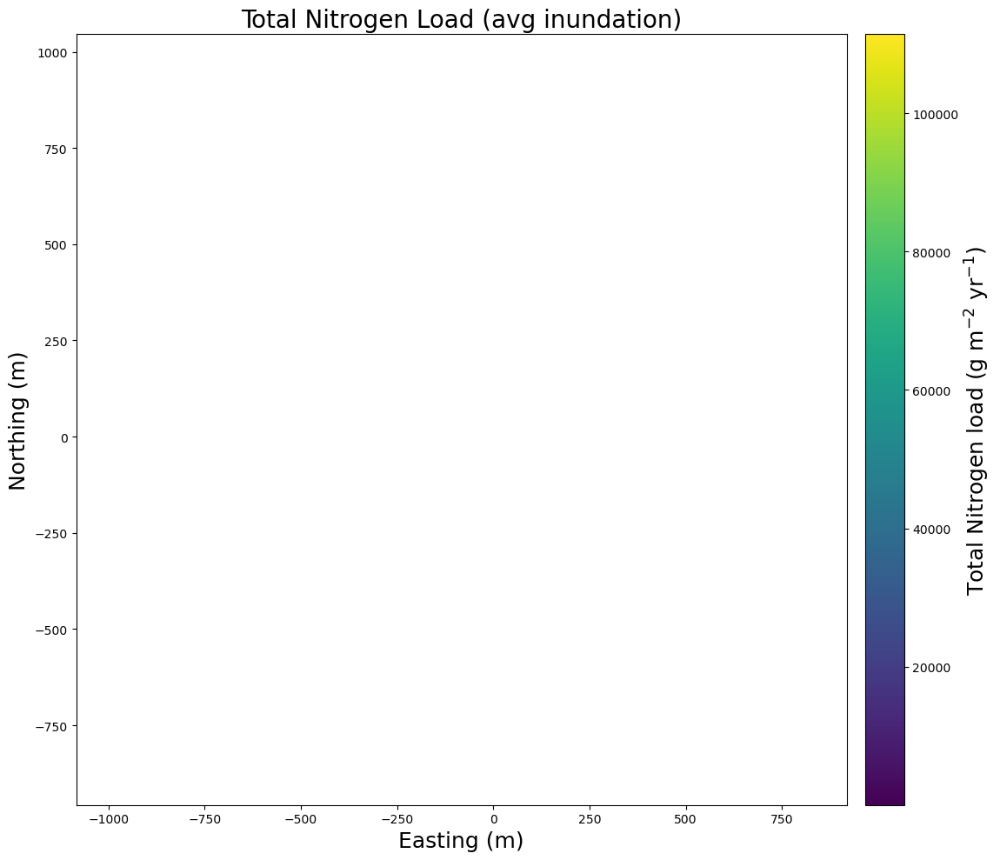

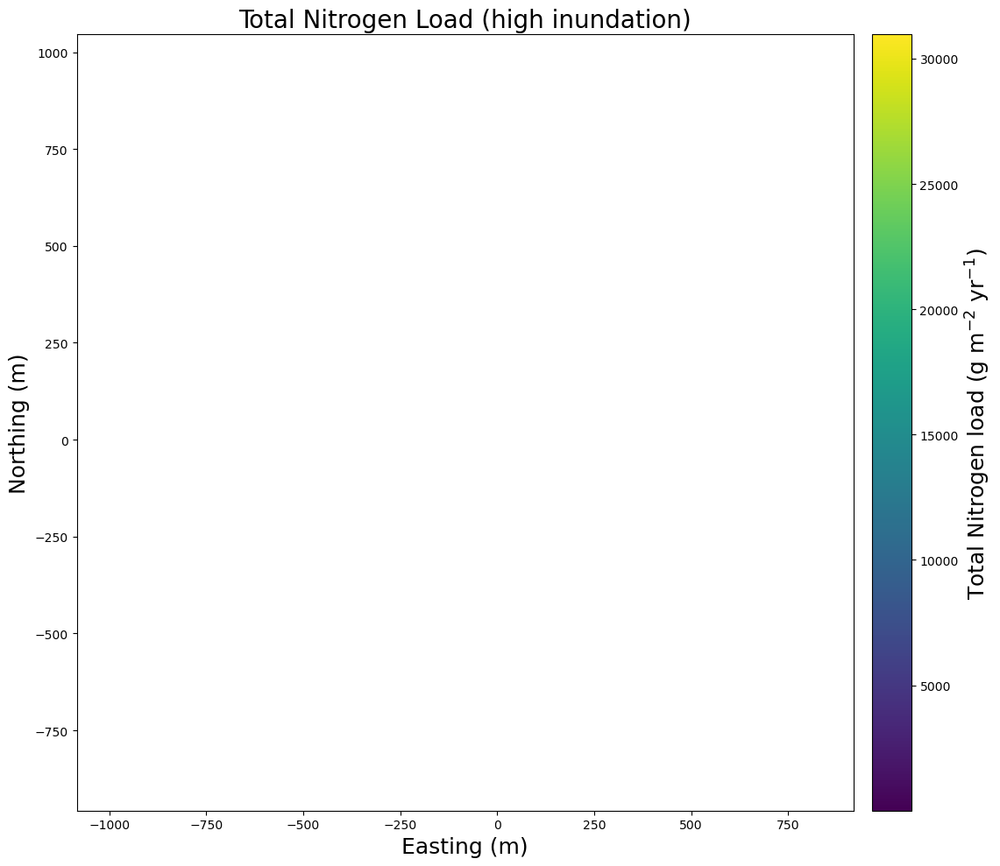

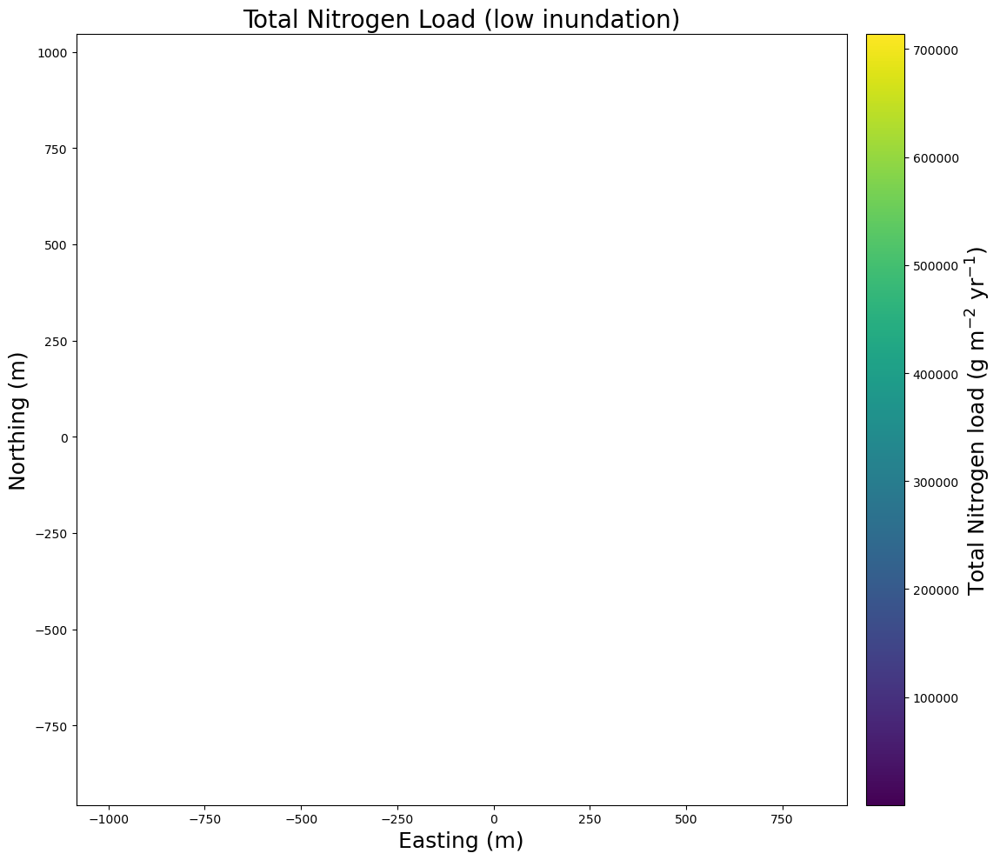

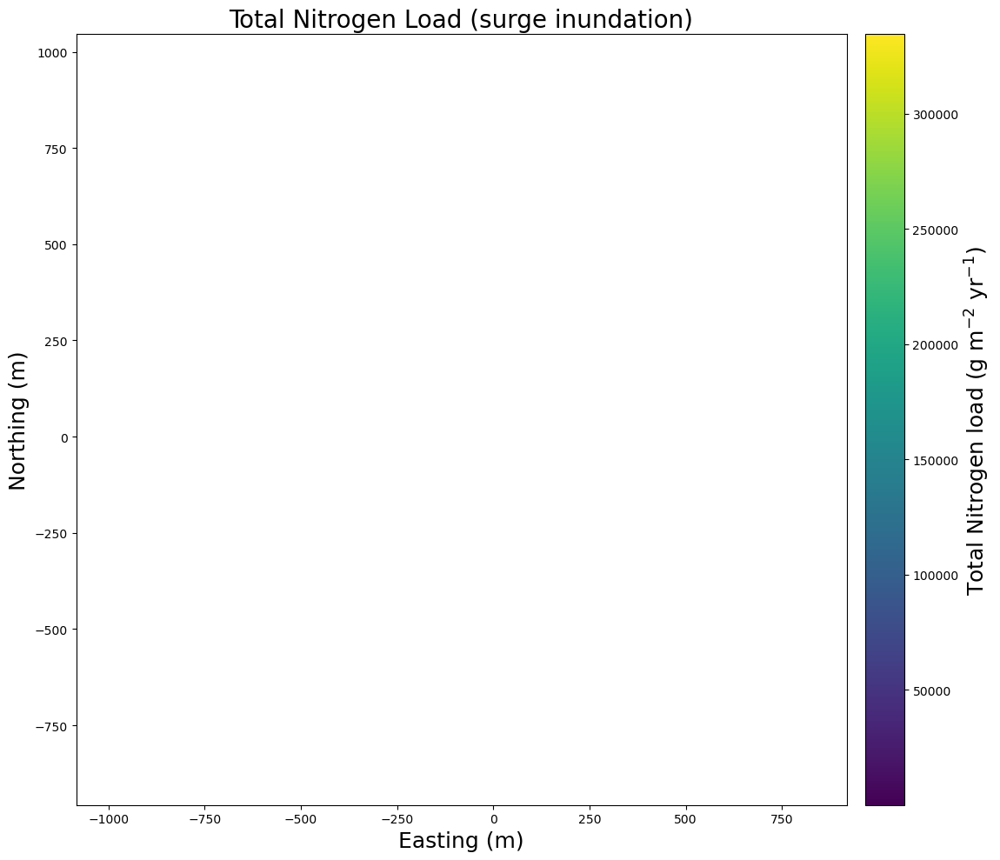

In [40]:
for cat in ['avg', 'high', 'low', 'surge']:
    plot_wetload_distribution(
        cat=cat,
        Lakes=Lakes,
        #Counties=counties,
        value_type="N",  # or "P"
        font_size=18,
        title=f"Total Nitrogen Load ({cat} inundation)",
        output_figures=out_dir
    )

In [42]:
Lakes

,featurecla,scalerank,name,name_abb,name_alt,note,delta,dam_name,year,admin,...,name_ru,name_sv,name_tr,name_vi,name_zh,wdid_score,ne_id,BUFF_DIST,ORIG_FID,geometry
0,Lake,0,Lake Erie,L. Erie,Great Lakes,None,None,None,-99,admin-0,...,Эри,Eriesjön,Erie Gölü,Hồ Erie,伊利湖,4,1159106757,3.0,0,"POLYGON ((1455895.589 735243.03, 1455647.023 7..."
1,Lake,0,Lake Ontario,L. Ontario,Great Lakes,None,None,None,-99,admin-0,...,Онтарио,Ontariosjön,Ontario Gölü,Hồ Ontario,安大略湖,4,1159106765,3.0,1,"POLYGON ((1680197.449 898043.871, 1670861.77 8..."
2,Lake,0,Lake Saint Clair,L. St. Clair,Great Lakes,None,None,None,-99,admin-0,...,Сент-Клэр,Lake St. Clair,None,None,聖克萊爾湖,5,1159106775,3.0,2,"POLYGON ((1169569.815 662806.134, 1169689.006 ..."
3,Lake,0,Lake Superior,L. Superior,Great Lakes,None,None,None,-99,admin-0,...,Верхнее,Övre sjön,Superior Gölü,Hồ Thượng,苏必利尔湖,4,1159112991,3.0,3,"POLYGON ((741461.864 1391020.299, 741498.382 1..."
4,Lake,0,Lake Michigan,L. Michigan,Great Lakes,None,None,None,-99,admin-0,...,Мичиган,Michigansjön,Michigan Gölü,Hồ Michigan,密歇根湖,4,1159113005,3.0,4,"POLYGON ((929657.296 1062869.209, 929758.857 1..."
5,Lake,0,Lake Huron,L. Huron,Great Lakes,None,None,None,-99,admin-0,...,Гурон,Huronsjön,Huron Gölü,Hồ Huron,休伦湖,3,1159113021,3.0,5,"POLYGON ((1027013.65 1115637.35, 1042424.887 1..."


In [ ]:
for cat in ['avg', 'high', 'low', 'surge']:
    plot_wetload_distribution(
        cat=cat,
        Lakes=Lakes,
        Counties=counties,
        value_type="P",  # or "P"
        font_size=18,
        title=f"Total Phosphorus Load ({cat} inundation)",
        output_figures=out_dir
    )

### wetlands geographic location 

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import geopandas as gpd
import os

def plot_wetload_distribution(
    cat,
    Lakes: gpd.GeoDataFrame,
    font_size=16,
    title=None,
    output_figures='.',
    extent=[-85, -81, 42.5, 46.5]
):
    # Get dataframe from globals
    df = globals().get(f'TotalLoad_CW_{cat}')
    if df is None:
        raise ValueError(f"No dataframe found for category '{cat}'")

    # Clean invalid coordinates
    df = df[
        (df['start_lon'] != 0.0) &
        (df['start_lat'] != 0.0) &
        (~df['start_lon'].isna()) &
        (~df['start_lat'].isna())
    ].copy()

    # Require Wetland column
    if 'Wetland' not in df.columns:
        raise ValueError("Column 'Wetland' not found in dataframe")

    # Clip to extent
    minx, maxx, miny, maxy = extent
    df = df[
        (df['start_lon'] >= minx) & (df['start_lon'] <= maxx) &
        (df['start_lat'] >= miny) & (df['start_lat'] <= maxy)
    ].copy()

    # Unique wetland categories (sorted for stable legend order)
    cats = sorted([c for c in df['Wetland'].dropna().unique()])

    # Choose a palette with enough distinct colors
    cmap = plt.get_cmap('tab10')
    color_map = {c: cmap(i % cmap.N) for i, c in enumerate(cats)}

    # --- Plot ---
    fig, ax = plt.subplots(figsize=(18, 10))

    # Lakes
    Lakes.plot(ax=ax, facecolor='lightblue', edgecolor='black', alpha=0.5, zorder=0)

    # Scatter points by wetland category
    for c in cats:
        sub = df[df['Wetland'] == c]
        ax.scatter(
            sub['start_lon'], sub['start_lat'],
            s=25, alpha=0.9, label=f"{c} (n={len(sub)})",
            color=color_map[c], zorder=1
        )

    # Labels and layout
    ax.set_title(title or f"Wetland Categories - {cat}", fontsize=font_size + 2)
    ax.set_xlabel("Longitude", fontsize=font_size)
    ax.set_ylabel("Latitude", fontsize=font_size)
    ax.tick_params(labelsize=font_size - 2)
    ax.set_xlim(minx, maxx)
    ax.set_ylim(miny, maxy)
    ax.set_aspect('equal')

    # Legend outside the plot
    ax.legend(title="Wetland", bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0., fontsize=font_size-3)

    # Save figure
    os.makedirs(output_figures, exist_ok=True)
    outpath = f"{output_figures}/WetlandCats_{cat}.png"
    plt.savefig(outpath, dpi=300, bbox_inches='tight')
    print(f"✅ Saved: {outpath}")
    plt.show()


In [ ]:
for cat in ['avg', 'high', 'low', 'surge']:
    plot_wetload_distribution(
        cat=cat,
        Lakes=Lakes,
        output_figures="figures",
        title=f"Wetland Categories - {cat}"
    )